# Calculating the target variable: Manifesto Alignment

This notebook loads in 1) embeddings from parliamentary dialogue data grouped for party and day and 2) embeddings from party manifestos. Then, manifesto alignment is derived as the Euclidean distance between, for each day and party, the vector i) for grouped party utterance and ii) corresponding latest party manifesto.

## Visualsations 
The bottom of the notebook includes some visualisations.

In [2]:
directory_path = "/Users/pbrams/Desktop/AARHUS_UNIVERSITY/kandidat/data_sci/data_sci_project/predicting_manifesto_alignment"

In [3]:
# Functions to load embeddings from a filename into the df in the right format (embeddings get corrupted if saved and loaded in as .csv cell values, so need to load in directly from .npy's)
import numpy as np
import os

def load_embedding(filepath):
    return np.load(filepath)

def load_embeddings_to_dataframe(df, embeddings_dir, embedding_col='embedding_filename'):
    embeddings = []
    for index, row in df.iterrows():
        embedding_path = os.path.join(embeddings_dir, row[embedding_col])
        if os.path.exists(embedding_path):
            embedding = load_embedding(embedding_path)
            embeddings.append(embedding)
        else:
            print(f"Embedding file {embedding_path} does not exist.")
            embeddings.append(None)
    
    # Add the embeddings as a new column in the df
    df['embedding'] = embeddings
    return df

## Loading in parliamentary dialogue embeddings

In [4]:
import pandas as pd

# Get data with filenames
dialogue_emb = pd.read_csv(f"{directory_path}/data/preprocessed/clean/parliamentary_dialogue/merged/parliamentary_dialogue_1997_2022_with_embedding_filenames.csv")

# Directory where dialogue embeddings are saved
embeddings_dir_dialogue = f"{directory_path}/data/preprocessed/embeddings/speech1997_2022_BERT"

# Load the embeddings into the df
dialogue_emb_with_embeddings = load_embeddings_to_dataframe(dialogue_emb, embeddings_dir_dialogue)

# See the df with the new 'embedding' column
dialogue_emb_with_embeddings

dialogue_emb_with_embeddings

,Date,Party_Name,processed_text,embedding_filename,embedding
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564..."
1,1997-10-09,Dansk Folkeparti,ligesom åbningstalen kom udlændingeafsnittet s...,1_1997-10-09 00:00:00_Dansk Folkeparti.npy,"[0.04652552, 0.36598074, -0.21167178, -0.05009..."
2,1997-10-09,Det Radikale Venstre,lad allerførst starte konstatere bennedsens v...,2_1997-10-09 00:00:00_Det Radikale Venstre.npy,"[0.21820638, 0.4901901, -0.1592107, -0.3214094..."
3,1997-10-09,Enhedslisten,taler indgreb imod stigende forbrug anledning...,3_1997-10-09 00:00:00_Enhedslisten.npy,"[0.25565338, 0.3768624, -0.21514736, -0.191082..."
4,1997-10-09,Konservative Folkeparti,oprigtig talt dybt beskæmmende kan prøve bort...,4_1997-10-09 00:00:00_Konservative Folkeparti.npy,"[0.30833158, 0.39645094, -0.219684, -0.0888011..."
...,...,...,...,...,...
20040,2022-06-07,Konservative Folkeparti,egentlig bare helt grundlæggende godt tænke vi...,20040_2022-06-07 00:00:00_Konservative Folkepa...,"[-0.0744784, 0.4140956, -0.23889333, -0.260567..."
20041,2022-06-07,Nye Borgerlige,nye debat set haft siden valgt folketinget ...,20041_2022-06-07 00:00:00_Nye Borgerlige.npy,"[-0.11498207, 0.24510184, -0.049303785, -0.126..."
20042,2022-06-07,Socialdemokratiet,simpelt hen glad dag simpelt hen nødt orde...,20042_2022-06-07 00:00:00_Socialdemokratiet.npy,"[0.21544588, 0.33381942, -0.071298495, -0.0850..."
20043,2022-06-07,Socialistisk Folkeparti,ordet muligvis velset inden sommerferien forl...,20043_2022-06-07 00:00:00_Socialistisk Folkepa...,"[0.11376296, 0.40788174, -0.21000698, -0.10168..."


## Loading in manifesto embeddings

In [5]:
import pandas as pd

# Get data with filenames
manifestos_emb = pd.read_csv(f"{directory_path}/data/preprocessed/clean/manifestos/clean_manifestos_1997_2022_with_embedding_filenames.csv").drop(columns = ['Unnamed: 0'])

# Directory where dialogue embeddings are saved
embeddings_dir_manifesto = f"{directory_path}/data/preprocessed/embeddings/manifesto_BERT_embeddings_1997_2022"

# Load the embeddings into the df
manifestos_emb_with_embeddings = load_embeddings_to_dataframe(manifestos_emb, embeddings_dir_manifesto)

# See the df with the new 'embedding' column
manifestos_emb_with_embeddings

,Party_Name,Year,text,processed_text,token_count,embedding_filename,embedding
0,Alternativet,2015,Alternativet Alternativet er klar til valg Dan...,klar valg danmark står tre alvorlige kriser kl...,1858,0_2015_Alternativet.npy,"[0.3680797, 0.28119645, -0.12563303, -0.132177..."
1,Alternativet,2019,Vores Politik På denne side finder du Alternat...,politik side finder politik politiske visione...,15879,1_2019_Alternativet.npy,"[0.5636211, 0.2946402, -0.18254907, -0.0433557..."
2,Dansk Folkeparti,1998,UDLÆNDINGEPOLITIKKEN UD med særlove og hovsa-l...,udlændingepolitikken særlove hovsaløsninger fo...,288,2_1998_Dansk Folkeparti.npy,"[0.53842527, 0.356656, 0.14019331, 0.06150116,..."
3,Dansk Folkeparti,2001,Fælles værdier – fælles ansvar Arbejdsprogram...,fælles værdier – fælles ansvar arbejdsprogram ...,19173,3_2001_Dansk Folkeparti.npy,"[0.58375436, 0.30470967, 0.035680268, -0.17023..."
4,Dansk Folkeparti,2005,Vi vil have et trygt land Danmark skal være et...,trygt land danmark trygt sikkert sted land bor...,304,4_2005_Dansk Folkeparti.npy,"[0.087004185, 0.44123638, -0.21783036, -0.3128..."
...,...,...,...,...,...,...,...
57,Venstre,2005,Valgløfter Danmark skal være verdensmestre i v...,valgløfter danmark verdensmestre viden frem af...,1879,57_2005_Venstre.npy,"[0.29519907, 0.4058113, -0.21492215, -0.035944..."
58,Venstre,2007,Valggrundlag Folketingsvalg 13. november 2007 ...,valggrundlag folketingsvalg november endnu bed...,1169,58_2007_Venstre.npy,"[0.5067126, 0.47140595, -0.2079314, 0.08938522..."
59,Venstre,2011,Nye tider. Varig velfærd Der er udskrevet folk...,nye tider varig velfærd udskrevet folketingsva...,1729,59_2011_Venstre.npy,"[0.42306575, 0.5086403, -0.10323133, 0.0333439..."
60,Venstre,2015,DET VIL VENSTRE Ydelser til flygtninge skal ne...,ydelser flygtninge suniveau gør mindre attrak...,730,60_2015_Venstre.npy,"[0.023002222, -0.02097416, -0.20707527, -0.094..."


In [6]:
# Using pivot_table to reshape the df
df_pivot = manifestos_emb_with_embeddings.pivot_table(index='Party_Name', 
                          columns='Year', 
                          values=['text', 'processed_text', 'token_count', 'embedding_filename', 'embedding'],
                          aggfunc='first')  # there's only one row per party per year, so we can do this

# Flatten the MultiIndex in columns created by pivot_table
df_pivot.columns = [f'{col[0]}_{col[1]}_manifesto' for col in df_pivot.columns.values]

# Reset index to turn the indices into a column
df_pivot.reset_index(inplace=True)

# Take a look
df_pivot

,Party_Name,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,embedding_2011_manifesto,embedding_2015_manifesto,embedding_2019_manifesto,embedding_filename_1994_manifesto,...,text_2015_manifesto,text_2019_manifesto,token_count_1994_manifesto,token_count_1998_manifesto,token_count_2001_manifesto,token_count_2005_manifesto,token_count_2007_manifesto,token_count_2011_manifesto,token_count_2015_manifesto,token_count_2019_manifesto
0,Alternativet,NaN,NaN,NaN,NaN,NaN,NaN,"[0.3680797, 0.28119645, -0.12563303, -0.132177...","[0.5636211, 0.2946402, -0.18254907, -0.0433557...",NaN,...,Alternativet Alternativet er klar til valg Dan...,Vores Politik På denne side finder du Alternat...,NaN,NaN,NaN,NaN,NaN,NaN,1858.0,15879.0
1,Dansk Folkeparti,NaN,"[0.53842527, 0.356656, 0.14019331, 0.06150116,...","[0.58375436, 0.30470967, 0.035680268, -0.17023...","[0.087004185, 0.44123638, -0.21783036, -0.3128...","[0.39599568, 0.3402632, -0.16936597, -0.158748...","[0.16432035, 0.42095682, -0.16953579, 0.056804...","[0.39005142, 0.4645717, 0.19545913, 0.03084557...","[-0.056619585, 0.49869037, -0.2388436, -0.1939...",NaN,...,Tryghed og tillid – det er dit valg At vi kan ...,Mærkesager Dansk Folkepartis mål er at bevare ...,NaN,288.0,19173.0,304.0,378.0,2949.0,278.0,908.0
2,Det Radikale Venstre,"[0.33045512, 0.68439555, -0.42080617, -0.33199...","[0.5159543, 0.32359782, 0.1730595, -0.18681994...","[0.28334728, 0.45769462, -0.204691, -0.1650081...","[-0.13586926, 0.18178172, -0.2632126, 0.382178...","[0.12599623, 0.20413575, -0.5082123, 0.0449172...","[0.5861566, 0.46592742, -0.02941766, 0.1446643...","[0.7289334, 0.49251902, -0.28765157, 0.0844615...","[0.5064914, 0.44100526, -0.1276514, -0.0151175...",9_1994_Det Radikale Venstre.npy,...,Radikale B 21-09-2014 Politisk ramme for det n...,Det mener vi om... ARBEJDSMARKED Hvordan får v...,382.0,1139.0,464.0,425.0,282.0,1003.0,229.0,5539.0
3,Enhedslisten,"[0.41575432, 0.1980167, -0.0334731, -0.0877491...","[0.72878724, 0.41506422, -0.10675957, -0.12566...","[0.5899429, 0.4924652, -0.08506531, -0.1848320...","[0.522868, 0.63749623, -0.26305518, 0.07203100...","[0.45634463, 0.50945765, -0.16354465, -0.20413...","[0.3744932, 0.45836413, -0.015394982, -0.08708...","[0.52578574, 0.5301758, -0.20267148, -0.071686...","[0.66962093, 0.46855626, -0.08335286, 0.018208...",17_1994_Enhedslisten.npy,...,Skab tryghed og arbejdspladser Angrebene på da...,Arbejdsmarked Ordentlige vilkår på arbejdsmark...,678.0,779.0,1546.0,1270.0,2113.0,4504.0,877.0,2641.0
4,Konservative Folkeparti,"[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...","[0.5120871, 0.22931804, -0.7401633, 0.13540547...","[0.1311108, 0.330008, -0.19596335, -0.36973634...","[0.46792188, 0.2875277, -0.22564729, 0.0589802...",25_1994_Konservative Folkeparti.npy,...,Mennesker først Søren Pape Jeg sætter Menneske...,Vores politik Det Konservative Folkeparti er e...,1024.0,1563.0,542.0,1008.0,936.0,940.0,305.0,7730.0
5,Liberal Alliance,NaN,NaN,NaN,NaN,"[0.4191654, 0.26258788, -0.025826603, -0.10570...","[0.29151616, 0.4288164, -0.22915614, 0.0208234...","[0.24702467, 0.29379052, -0.24468753, 0.081695...","[0.34263444, 0.45312595, -0.0816405, -0.154057...",NaN,...,VORES FIRE MÆRKESAGER Mere Frihed Vi er gode t...,117 gode grunde til at stemme på Liberal Allia...,NaN,NaN,NaN,NaN,358.0,516.0,1064.0,1969.0
6,Nye Borgerlige,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[0.52032447, 0.308004, 0.026918098, 0.04305453...",NaN,...,NaN,Vores Politik Ældrepolitik Folkepensionen skal...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5826.0
7,Socialdemokratiet,"[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438,

## Calculating alignment

In [7]:
# Merging
df_doc_m = pd.merge(dialogue_emb_with_embeddings,df_pivot[['Party_Name', 
                                      'embedding_1994_manifesto', 
                                      'embedding_1998_manifesto',
                                      'embedding_2001_manifesto', 
                                      'embedding_2005_manifesto',
                                      'embedding_2007_manifesto', 
                                      'embedding_2011_manifesto',
                                      'embedding_2015_manifesto', 
                                      'embedding_2019_manifesto',
   
                                      'token_count_1994_manifesto',
                                      'token_count_1998_manifesto', 
                                      'token_count_2001_manifesto',
                                      'token_count_2005_manifesto', 
                                      'token_count_2007_manifesto',
                                      'token_count_2011_manifesto', 
                                      'token_count_2015_manifesto',
                                      'token_count_2019_manifesto'
                                      ]],on='Party_Name', how='left')

df_doc_m


,Date,Party_Name,processed_text,embedding_filename,embedding,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,...,embedding_2015_manifesto,embedding_2019_manifesto,token_count_1994_manifesto,token_count_1998_manifesto,token_count_2001_manifesto,token_count_2005_manifesto,token_count_2007_manifesto,token_count_2011_manifesto,token_count_2015_manifesto,token_count_2019_manifesto
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564...","[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438, -0.19089846, -0.043219...","[0.45210513, 0.3505535, -0.10954473, -0.156487...",...,"[0.41460475, 0.4271878, -0.22612953, 0.0029190...","[0.32285914, 0.48267242, -0.22120975, -0.05167...",1430.0,2273.0,8593.0,1747.0,958.0,1146.0,2932.0,19204.0
1,1997-10-09,Dansk Folkeparti,ligesom åbningstalen kom udlændingeafsnittet s...,1_1997-10-09 00:00:00_Dansk Folkeparti.npy,"[0.04652552, 0.36598074, -0.21167178, -0.05009...",NaN,"[0.53842527, 0.356656, 0.14019331, 0.06150116,...","[0.58375436, 0.30470967, 0.035680268, -0.17023...","[0.087004185, 0.44123638, -0.21783036, -0.3128...","[0.39599568, 0.3402632, -0.16936597, -0.158748...",...,"[0.39005142, 0.4645717, 0.19545913, 0.03084557...","[-0.056619585, 0.49869037, -0.2388436, -0.1939...",NaN,288.0,19173.0,304.0,378.0,2949.0,278.0,908.0
2,1997-10-09,Det Radikale Venstre,lad allerførst starte konstatere bennedsens v...,2_1997-10-09 00:00:00_Det Radikale Venstre.npy,"[0.21820638, 0.4901901, -0.1592107, -0.3214094...","[0.33045512, 0.68439555, -0.42080617, -0.33199...","[0.5159543, 0.32359782, 0.1730595, -0.18681994...","[0.28334728, 0.45769462, -0.204691, -0.1650081...","[-0.13586926, 0.18178172, -0.2632126, 0.382178...","[0.12599623, 0.20413575, -0.5082123, 0.0449172...",...,"[0.7289334, 0.49251902, -0.28765157, 0.0844615...","[0.5064914, 0.44100526, -0.1276514, -0.0151175...",382.0,1139.0,464.0,425.0,282.0,1003.0,229.0,5539.0
3,1997-10-09,Enhedslisten,taler indgreb imod stigende forbrug anledning...,3_1997-10-09 00:00:00_Enhedslisten.npy,"[0.25565338, 0.3768624, -0.21514736, -0.191082...","[0.41575432, 0.1980167, -0.0334731, -0.0877491...","[0.72878724, 0.41506422, -0.10675957, -0.12566...","[0.5899429, 0.4924652, -0.08506531, -0.1848320...","[0.522868, 0.63749623, -0.26305518, 0.07203100...","[0.45634463, 0.50945765, -0.16354465, -0.20413...",...,"[0.52578574, 0.5301758, -0.20267148, -0.071686...","[0.66962093, 0.46855626, -0.08335286, 0.018208...",678.0,779.0,1546.0,1270.0,2113.0,4504.0,877.0,2641.0
4,1997-10-09,Konservative Folkeparti,oprigtig talt dybt beskæmmende kan prøve bort...,4_1997-10-09 00:00:00_Konservative Folkeparti.npy,"[0.30833158, 0.39645094, -0.219684, -0.0888011...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,"[0.1311108, 0.330008, -0.19596335, -0.36973634...","[0.46792188, 0.2875277, -0.22564729, 0.0589802...",1024.0,1563.0,542.0,1008.0,936.0,940.0,305.0,7730.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20040,2022-06-07,Konservative Folkeparti,egentlig bare helt grundlæggende godt tænke vi...,20040_2022-06-07 00:00:00_Konservative Folkepa...,"[-0.0744784, 0.4140956, -0.23889333, -0.260567...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,"[0.1311108, 0.330008, -0.19596335, -0.36973634...","[0.46

### Calculating measures

In the below Euclidean distance is calculated along with PCA distance and cosine similarity, though the latter two here are not used in the present analyses.

In [8]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial.distance import euclidean
from sklearn.metrics.pairwise import cosine_similarity

# Ensure embeddings are properly formatted as numpy arrays
df_doc_m['embedding'] = df_doc_m['embedding'].apply(np.array)

# List of manifesto embeddings and corresponding years
list_mani_embds = [
    ('embedding_1994_manifesto', 1994),
    ('embedding_1998_manifesto', 1998),
    ('embedding_2001_manifesto', 2001),
    ('embedding_2005_manifesto', 2005),
    ('embedding_2007_manifesto', 2007),
    ('embedding_2011_manifesto', 2011),
    ('embedding_2015_manifesto', 2015),
    ('embedding_2019_manifesto', 2019)
]

# Ensure manifesto embeddings are properly formatted as numpy arrays
for col, _ in list_mani_embds:
    df_doc_m[col] = df_doc_m[col].apply(np.array)

# Prepare the embeddings
embeddings = np.array(df_doc_m['embedding'].tolist())

# Perform PCA on the embeddings
pca = PCA(n_components=2)
embeddings_pca = pca.fit_transform(embeddings)

# Save PCA components back to the df
df_doc_m['PCA Component 1'] = embeddings_pca[:, 0]
df_doc_m['PCA Component 2'] = embeddings_pca[:, 1]

# Function to calculate Euclidean distances between PCA-transformed embeddings
def calculate_pca_euclidean(emb_pca, manifesto_pca, party, manifesto_col):
    if np.isnan(manifesto_pca).any():
        print(f"NaN found for {party} in manifesto col {manifesto_col}")
        return np.nan  # Return NaN if the manifesto embedding is NaN
    return euclidean(emb_pca, manifesto_pca)

# Function to calculate Euclidean distances between original embeddings
def calculate_euclidean(emb1, emb2):
    if isinstance(emb1, np.ndarray) and isinstance(emb2, np.ndarray):
        return euclidean(emb1, emb2)
    return np.nan

# Iterate over manifesto years and calculate distances
for col, year in list_mani_embds:
    # Euclidean distance between PCA-transformed embeddings
    pca_distance_col = f'euclidean_pca_dist_{year}'
    df_doc_m[pca_distance_col] = df_doc_m.apply(lambda row: calculate_pca_euclidean(
        row[['PCA Component 1', 'PCA Component 2']].values,
        pca.transform([row[col]]).squeeze() if not np.isnan(row[col]).any() else np.nan,
        row['Party_Name'], col), axis=1)

    # Euclidean distance between original embeddings
    distance_col = f'euclidean_dist_{year}'
    df_doc_m[distance_col] = df_doc_m.apply(lambda row: calculate_euclidean(row['embedding'], row[col]), axis=1)

# Define a function to calculate cosine similarity
def calculate_cosine_similarity(emb1, emb2):
    if isinstance(emb1, np.ndarray) and isinstance(emb2, np.ndarray):
        return cosine_similarity([emb1], [emb2])[0][0]
    return np.nan

# Calculate cosine similarity and create new columns
for col, year in list_mani_embds:
    df_doc_m[f'cosine_similarity_{year}'] = df_doc_m.apply(lambda row: calculate_cosine_similarity(row['embedding'], row[col]), axis=1)

# Take a look
df_doc_m


NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col embedding_1994_manifesto
NaN found for Dansk Folkeparti in manifesto col emb

,Date,Party_Name,processed_text,embedding_filename,embedding,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,...,euclidean_pca_dist_2019,euclidean_dist_2019,cosine_similarity_1994,cosine_similarity_1998,cosine_similarity_2001,cosine_similarity_2005,cosine_similarity_2007,cosine_similarity_2011,cosine_similarity_2015,cosine_similarity_2019
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564...","[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438, -0.19089846, -0.043219...","[0.45210513, 0.3505535, -0.10954473, -0.156487...",...,3.334446,5.765357,0.884362,0.895500,0.878029,0.858812,0.891166,0.804399,0.875293,0.880558
1,1997-10-09,Dansk Folkeparti,ligesom åbningstalen kom udlændingeafsnittet s...,1_1997-10-09 00:00:00_Dansk Folkeparti.npy,"[0.04652552, 0.36598074, -0.21167178, -0.05009...",NaN,"[0.53842527, 0.356656, 0.14019331, 0.06150116,...","[0.58375436, 0.30470967, 0.035680268, -0.17023...","[0.087004185, 0.44123638, -0.21783036, -0.3128...","[0.39599568, 0.3402632, -0.16936597, -0.158748...",...,4.145682,7.356410,NaN,0.745128,0.828411,0.835981,0.847252,0.902457,0.769652,0.836261
2,1997-10-09,Det Radikale Venstre,lad allerførst starte konstatere bennedsens v...,2_1997-10-09 00:00:00_Det Radikale Venstre.npy,"[0.21820638, 0.4901901, -0.1592107, -0.3214094...","[0.33045512, 0.68439555, -0.42080617, -0.33199...","[0.5159543, 0.32359782, 0.1730595, -0.18681994...","[0.28334728, 0.45769462, -0.204691, -0.1650081...","[-0.13586926, 0.18178172, -0.2632126, 0.382178...","[0.12599623, 0.20413575, -0.5082123, 0.0449172...",...,4.075559,5.728457,0.868941,0.815185,0.817064,0.704886,0.837609,0.879213,0.765065,0.895685
3,1997-10-09,Enhedslisten,taler indgreb imod stigende forbrug anledning...,3_1997-10-09 00:00:00_Enhedslisten.npy,"[0.25565338, 0.3768624, -0.21514736, -0.191082...","[0.41575432, 0.1980167, -0.0334731, -0.0877491...","[0.72878724, 0.41506422, -0.10675957, -0.12566...","[0.5899429, 0.4924652, -0.08506531, -0.1848320...","[0.522868, 0.63749623, -0.26305518, 0.07203100...","[0.45634463, 0.50945765, -0.16354465, -0.20413...",...,3.677805,5.853915,0.847629,0.879257,0.897361,0.889195,0.883157,0.912352,0.848204,0.889898
4,1997-10-09,Konservative Folkeparti,oprigtig talt dybt beskæmmende kan prøve bort...,4_1997-10-09 00:00:00_Konservative Folkeparti.npy,"[0.30833158, 0.39645094, -0.219684, -0.0888011...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,3.001358,5.016001,0.877056,0.816460,0.875499,0.876332,0.846220,0.804457,0.836313,0.920428
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20040,2022-06-07,Konservative Folkeparti,egentlig bare helt grundlæggende godt tænke vi...,20040_2022-06-07 00:00:00_Konservative Folkepa...,"[-0.0744784, 0.4140956, -0.23889333, -0.260567...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,4.139137,6.193974,0.813876,0.751508,0.820369,0.807948,0.793988,0.758082,0.846655,0.885201
20041,2022-06-07,Nye Borgerlige,nye debat set haft siden valgt folketinget ...,20041_2022-06-07 00:00:00_Nye Borgerlige.npy,"[-0.11498207, 0.24510184, -0.049303785, -0.126...",NaN,NaN,NaN,NaN,NaN,...,4.035097,6.553987,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.856285
20042,2022-06-07,Socialdemokratiet,simpelt hen glad dag simpelt hen nødt orde...,20042_

### Code for ensuring complete dates

In [9]:
def ensure_complete_dates(df):

    # 'Date' should already be a datetime type; if not, convert
    df['Date'] = pd.to_datetime(df['Date'])
    
    # Create a date range that covers all dates in the df
    date_range = pd.date_range(start=df['Date'].min(), end=df['Date'].max())
    
    # Create a complete df with all combinations of 'Date' and 'Party_Name'
    parties = df['Party_Name'].unique()
    complete_df = pd.MultiIndex.from_product([date_range, parties], names=['Date', 'Party_Name']).to_frame(index=False)
    
    # Merge the complete df with the original data, keeping all rows from the complete frame
    df_complete = pd.merge(complete_df, df, on=['Date', 'Party_Name'], how='left')
    
    return df_complete

# Apply this function to df before plotting
df_complete = ensure_complete_dates(df_doc_m)

df_complete

,Date,Party_Name,processed_text,embedding_filename,embedding,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,...,euclidean_pca_dist_2019,euclidean_dist_2019,cosine_similarity_1994,cosine_similarity_1998,cosine_similarity_2001,cosine_similarity_2005,cosine_similarity_2007,cosine_similarity_2011,cosine_similarity_2015,cosine_similarity_2019
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564...","[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438, -0.19089846, -0.043219...","[0.45210513, 0.3505535, -0.10954473, -0.156487...",...,3.334446,5.765357,0.884362,0.8955,0.878029,0.858812,0.891166,0.804399,0.875293,0.880558
1,1997-10-07,Dansk Folkeparti,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1997-10-07,Det Radikale Venstre,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1997-10-07,Enhedslisten,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1997-10-07,Konservative Folkeparti,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
171185,2022-06-07,Javnaðarflokkurin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
171186,2022-06-07,Alternativet,tror efterhånden stået talerstol gange simpe...,20036_2022-06-07 00:00:00_Alternativet.npy,"[-0.12265729, 0.06713967, 0.41288495, 0.005394...",NaN,NaN,NaN,NaN,NaN,...,4.129890,7.685903,NaN,NaN,NaN,NaN,NaN,NaN,0.812823,0.803335
171187,2022-06-07,Nunatta Qitornai,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
171188,2022-06-07,Nye Borgerlige,nye debat set haft siden valgt folketinget ...,20041_2022-06-07 00:00:00_Nye Borgerlige.npy,"[-0.11498207, 0.24510184, -0.049303785, -0.126...",NaN,NaN,NaN,NaN,NaN,...,4.035097,6.553987,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.856285


### Filtering to only take parties in the data we have manifesto data for

In [10]:
# For simplicity: going to only take parties that we have all manifestos for 
print(df_pivot['Party_Name'].unique())
print(df_doc_m['Party_Name'].unique())

parties_in_pivot = df_pivot['Party_Name'].unique()

# Filter df_doc_m by only including party in Party_Name col if it exists in df_pivot party name
filtered_df_doc_m = df_doc_m[df_doc_m['Party_Name'].isin(parties_in_pivot)]

# Filter df_doc_m by only including party in Party_Name col if it exists in df_pivot party name
filtered_df_doc_m_complete_dates = df_complete[df_complete['Party_Name'].isin(parties_in_pivot)]

# Take a look
filtered_df_doc_m
filtered_df_doc_m_complete_dates

['Alternativet' 'Dansk Folkeparti' 'Det Radikale Venstre' 'Enhedslisten'
 'Konservative Folkeparti' 'Liberal Alliance' 'Nye Borgerlige'
 'Socialdemokratiet' 'Socialistisk Folkeparti' 'Venstre']
['Socialdemokratiet' 'Dansk Folkeparti' 'Det Radikale Venstre'
 'Enhedslisten' 'Konservative Folkeparti' 'Socialistisk Folkeparti'
 'Venstre' 'Inuit Ataqatigiit' 'Siumut' 'Tjóðveldi' 'Kristendemokraterne'
 'Uden for folketingsgrupperne' 'Liberal Alliance' 'Sambandsflokkurin'
 'Javnaðarflokkurin' 'Alternativet' 'Nunatta Qitornai' 'Nye Borgerlige'
 'Frie Grønne']


,Date,Party_Name,processed_text,embedding_filename,embedding,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,...,euclidean_pca_dist_2019,euclidean_dist_2019,cosine_similarity_1994,cosine_similarity_1998,cosine_similarity_2001,cosine_similarity_2005,cosine_similarity_2007,cosine_similarity_2011,cosine_similarity_2015,cosine_similarity_2019
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564...","[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438, -0.19089846, -0.043219...","[0.45210513, 0.3505535, -0.10954473, -0.156487...",...,3.334446,5.765357,0.884362,0.895500,0.878029,0.858812,0.891166,0.804399,0.875293,0.880558
1,1997-10-07,Dansk Folkeparti,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1997-10-07,Det Radikale Venstre,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1997-10-07,Enhedslisten,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1997-10-07,Konservative Folkeparti,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
171176,2022-06-07,Socialistisk Folkeparti,ordet muligvis velset inden sommerferien forl...,20043_2022-06-07 00:00:00_Socialistisk Folkepa...,"[0.11376296, 0.40788174, -0.21000698, -0.10168...","[0.7018268, 0.45293108, -0.11065726, -0.119338...","[0.61301035, 0.45661765, -0.3888379, -0.047371...","[0.6405949, 0.39134502, -0.07405329, -0.033153...","[0.52398646, 0.43192548, -0.15458575, -0.06129...","[0.43983194, 0.29108253, -0.34945667, -0.18179...",...,5.969149,7.371449,0.790440,0.850927,0.880512,0.856391,0.841997,0.890128,0.873118,0.842049
171177,2022-06-07,Venstre,socialdemokratiske behøver overrasket boligo...,20044_2022-06-07 00:00:00_Venstre.npy,"[0.117394276, 0.42845318, -0.2195878, -0.08028...","[0.3918447, 0.48336735, 0.4867327, -0.26660907...","[0.4812199, 0.11544505, -0.15377282, -0.077704...","[0.3773669, 0.47761276, 0.037994053, -0.400964...","[0.29519907, 0.4058113, -0.21492215, -0.035944...","[0.5067126, 0.47140595, -0.2079314, 0.08938522...",...,4.906283,7.049258,0.688916,0.770973,0.772747,0.835805,0.803802,0.825258,0.781650,0.855498
171183,2022-06-07,Liberal Alliance,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
171186,2022-06-07,Alternativet,tror efterhånden stået talerstol gange simpe...,20036_2022-06-07 00:00:00_Alternativet.npy,"[-0.12265729, 0.06713967, 0.41288495, 0.005394...",NaN,NaN,NaN,NaN,NaN,...,4.129890,7.685903,NaN,NaN,NaN,NaN,NaN,NaN,0.812823,0.803335


### Creating the dynamic alignment columns

In [11]:
import pandas as pd

# Election dates
election_dates = [
    pd.Timestamp('1994-09-21'),
    pd.Timestamp('1998-03-11'),
    pd.Timestamp('2001-11-20'),
    pd.Timestamp('2005-02-08'),
    pd.Timestamp('2007-11-13'),
    pd.Timestamp('2011-09-15'),
    pd.Timestamp('2015-06-18'),
    pd.Timestamp('2019-06-05'),
    pd.Timestamp('2022-11-01')  # Include this date even if unsure about data coverage
]

import pandas as pd

# Define election period boundaries
first_period_start = min(filtered_df_doc_m['Date'])
first_period_end = pd.Timestamp('1998-03-11')
second_period_start = pd.Timestamp('1998-03-11')
second_period_end = pd.Timestamp('2001-11-20')
third_period_start = pd.Timestamp('2001-11-20')
third_period_end = pd.Timestamp('2005-02-08')
fourth_period_start = pd.Timestamp('2005-02-08')
fourth_period_end = pd.Timestamp('2007-11-13')
fifth_period_start = pd.Timestamp('2007-11-13')
fifth_period_end = pd.Timestamp('2011-09-15')
sixth_period_start = pd.Timestamp('2011-09-15')
sixth_period_end = pd.Timestamp('2015-06-18')
seventh_period_start = pd.Timestamp('2015-06-18')
seventh_period_end = pd.Timestamp('2019-06-05')
eighth_period_start = pd.Timestamp('2019-06-05')
eighth_period_end = max(filtered_df_doc_m['Date'])

# Define function to create euclidean_dist_from_dynamic column
def create_euclidean_dist_from_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['euclidean_dist_1994']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['euclidean_dist_1998']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['euclidean_dist_2001']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['euclidean_dist_2005']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['euclidean_dist_2007']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['euclidean_dist_2011']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['euclidean_dist_2015']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['euclidean_dist_2019']
    else:
        return None

# Define function to create euclidean_dist_to_dynamic column
def create_euclidean_dist_to_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['euclidean_dist_1998']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['euclidean_dist_2001']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['euclidean_dist_2005']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['euclidean_dist_2007']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['euclidean_dist_2011']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['euclidean_dist_2015']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['euclidean_dist_2019']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['euclidean_dist_2019']  # In lack of better this is set
    else:
        return None


# Define function to create euclidean_dist_from_dynamic column
def create_euclidean_pca_dist_from_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['euclidean_pca_dist_1994']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['euclidean_pca_dist_1998']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['euclidean_pca_dist_2001']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['euclidean_pca_dist_2005']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['euclidean_pca_dist_2007']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['euclidean_pca_dist_2011']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['euclidean_pca_dist_2015']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['euclidean_pca_dist_2019']
    else:
        return None

# Define function to create euclidean_dist_to_dynamic column
def create_euclidean_pca_dist_to_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['euclidean_pca_dist_1998']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['euclidean_pca_dist_2001']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['euclidean_pca_dist_2005']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['euclidean_pca_dist_2007']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['euclidean_pca_dist_2011']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['euclidean_pca_dist_2015']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['euclidean_pca_dist_2019']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['euclidean_pca_dist_2019']  # In lack of better this is set
    else:
        return None


# Define function to create cosine_similarity_from_dynamic column
def create_cosine_similarity_from_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['cosine_similarity_1994']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['cosine_similarity_1998']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['cosine_similarity_2001']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['cosine_similarity_2005']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['cosine_similarity_2007']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['cosine_similarity_2011']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['cosine_similarity_2015']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['cosine_similarity_2019']
    else:
        return None

# Define function to create cosine_similarity_to_dynamic column
def create_cosine_similarity_to_dynamic(row):
    if first_period_start <= row['Date'] < first_period_end:
        return row['cosine_similarity_1998']
    elif second_period_start <= row['Date'] < second_period_end:
        return row['cosine_similarity_2001']
    elif third_period_start <= row['Date'] < third_period_end:
        return row['cosine_similarity_2005']
    elif fourth_period_start <= row['Date'] < fourth_period_end:
        return row['cosine_similarity_2007']
    elif fifth_period_start <= row['Date'] < fifth_period_end:
        return row['cosine_similarity_2011']
    elif sixth_period_start <= row['Date'] < sixth_period_end:
        return row['cosine_similarity_2015']
    elif seventh_period_start <= row['Date'] < seventh_period_end:
        return row['cosine_similarity_2019']
    elif eighth_period_start <= row['Date'] <= eighth_period_end:
        return row['cosine_similarity_2019']  # this is intentional
    else:
        return None

# ----- Apply functions to create euclidean cols
filtered_df_doc_m['euclidean_dist_from_dynamic'] = filtered_df_doc_m.apply(create_euclidean_dist_from_dynamic, axis=1)
filtered_df_doc_m['euclidean_dist_to_dynamic'] = filtered_df_doc_m.apply(create_euclidean_dist_to_dynamic, axis=1)

filtered_df_doc_m['euclidean_pca_dist_from_dynamic'] = filtered_df_doc_m.apply(create_euclidean_pca_dist_from_dynamic, axis=1)
filtered_df_doc_m['euclidean_pca_dist_to_dynamic'] = filtered_df_doc_m.apply(create_euclidean_pca_dist_to_dynamic, axis=1)

# ----- Apply functions to create cosine cols
filtered_df_doc_m['cosine_similarity_from_dynamic'] = filtered_df_doc_m.apply(create_cosine_similarity_from_dynamic, axis=1)
filtered_df_doc_m['cosine_similarity_to_dynamic'] = filtered_df_doc_m.apply(create_cosine_similarity_to_dynamic, axis=1)

# --- Applying the functions to the complete dates df as well
filtered_df_doc_m_complete_dates['euclidean_dist_from_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_euclidean_dist_from_dynamic, axis=1)
filtered_df_doc_m_complete_dates['euclidean_dist_to_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_euclidean_dist_to_dynamic, axis=1)

filtered_df_doc_m_complete_dates['euclidean_pca_dist_from_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_euclidean_pca_dist_from_dynamic, axis=1)
filtered_df_doc_m_complete_dates['euclidean_pca_dist_to_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_euclidean_pca_dist_to_dynamic, axis=1)

# Apply functions to create cosine cols
filtered_df_doc_m_complete_dates['cosine_similarity_from_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_cosine_similarity_from_dynamic, axis=1)
filtered_df_doc_m_complete_dates['cosine_similarity_to_dynamic'] = filtered_df_doc_m_complete_dates.apply(create_cosine_similarity_to_dynamic, axis=1)

filtered_df_doc_m

/var/folders/rp/y6c4hxp96_j_rq3k86806lgr0000gn/T/ipykernel_23787/254442849.py:165: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df_doc_m['euclidean_dist_from_dynamic'] = filtered_df_doc_m.apply(create_euclidean_dist_from_dynamic, axis=1)
/var/folders/rp/y6c4hxp96_j_rq3k86806lgr0000gn/T/ipykernel_23787/254442849.py:166: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df_doc_m['euclidean_dist_to_dynamic'] = filtered_df_doc_m.apply(create_euclidean_dist_to_dynamic, axis=1)
/var/folders/rp/y6c4

,Date,Party_Name,processed_text,embedding_filename,embedding,embedding_1994_manifesto,embedding_1998_manifesto,embedding_2001_manifesto,embedding_2005_manifesto,embedding_2007_manifesto,...,cosine_similarity_2007,cosine_similarity_2011,cosine_similarity_2015,cosine_similarity_2019,euclidean_dist_from_dynamic,euclidean_dist_to_dynamic,euclidean_pca_dist_from_dynamic,euclidean_pca_dist_to_dynamic,cosine_similarity_from_dynamic,cosine_similarity_to_dynamic
0,1997-10-07,Socialdemokratiet,år siden sagde flertal befolkningen ja europa ...,0_1997-10-07 00:00:00_Socialdemokratiet.npy,"[0.51218754, 0.3063812, -0.053304028, -0.07564...","[0.38461304, 0.48753864, -0.20939219, -0.18709...","[0.5376319, 0.5007749, -0.08809701, 0.04758605...","[0.42841527, 0.4785219, -0.08887992, -0.088802...","[0.33948922, 0.4364438, -0.19089846, -0.043219...","[0.45210513, 0.3505535, -0.10954473, -0.156487...",...,0.891166,0.804399,0.875293,0.880558,5.647436,5.347760,2.897563,2.733728,0.884362,0.895500
1,1997-10-09,Dansk Folkeparti,ligesom åbningstalen kom udlændingeafsnittet s...,1_1997-10-09 00:00:00_Dansk Folkeparti.npy,"[0.04652552, 0.36598074, -0.21167178, -0.05009...",NaN,"[0.53842527, 0.356656, 0.14019331, 0.06150116,...","[0.58375436, 0.30470967, 0.035680268, -0.17023...","[0.087004185, 0.44123638, -0.21783036, -0.3128...","[0.39599568, 0.3402632, -0.16936597, -0.158748...",...,0.847252,0.902457,0.769652,0.836261,NaN,8.962724,NaN,6.972586,NaN,0.745128
2,1997-10-09,Det Radikale Venstre,lad allerførst starte konstatere bennedsens v...,2_1997-10-09 00:00:00_Det Radikale Venstre.npy,"[0.21820638, 0.4901901, -0.1592107, -0.3214094...","[0.33045512, 0.68439555, -0.42080617, -0.33199...","[0.5159543, 0.32359782, 0.1730595, -0.18681994...","[0.28334728, 0.45769462, -0.204691, -0.1650081...","[-0.13586926, 0.18178172, -0.2632126, 0.382178...","[0.12599623, 0.20413575, -0.5082123, 0.0449172...",...,0.837609,0.879213,0.765065,0.895685,6.628503,7.460402,3.174371,5.509280,0.868941,0.815185
3,1997-10-09,Enhedslisten,taler indgreb imod stigende forbrug anledning...,3_1997-10-09 00:00:00_Enhedslisten.npy,"[0.25565338, 0.3768624, -0.21514736, -0.191082...","[0.41575432, 0.1980167, -0.0334731, -0.0877491...","[0.72878724, 0.41506422, -0.10675957, -0.12566...","[0.5899429, 0.4924652, -0.08506531, -0.1848320...","[0.522868, 0.63749623, -0.26305518, 0.07203100...","[0.45634463, 0.50945765, -0.16354465, -0.20413...",...,0.883157,0.912352,0.848204,0.889898,6.758869,6.122627,4.791134,4.113810,0.847629,0.879257
4,1997-10-09,Konservative Folkeparti,oprigtig talt dybt beskæmmende kan prøve bort...,4_1997-10-09 00:00:00_Konservative Folkeparti.npy,"[0.30833158, 0.39645094, -0.219684, -0.0888011...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,0.846220,0.804457,0.836313,0.920428,6.189305,7.417342,4.400614,6.004265,0.877056,0.816460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20040,2022-06-07,Konservative Folkeparti,egentlig bare helt grundlæggende godt tænke vi...,20040_2022-06-07 00:00:00_Konservative Folkepa...,"[-0.0744784, 0.4140956, -0.23889333, -0.260567...","[0.48079905, 0.4905901, 0.20899983, -0.0598760...","[0.48625246, 0.37680477, 0.11393484, -0.097780...","[0.35758147, 0.35199535, -0.14190832, -0.02912...","[0.26770902, 0.35430902, -0.3645144, -0.119786...","[0.43799758, 0.34637722, -0.0818209, -0.013597...",...,0.793988,0.758082,0.846655,0.885201,6.193974,6.193974,4.139137,4.139137,0.885201,0.885201
20041,2022-06-07,Nye Borgerlige,nye debat set haft siden valgt folketinget ...,20041_2022-06-07 00:00:00_Nye Borgerlige.npy,"[-0.11498207, 0.24510184, -0.049303785, -0.126...",NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.856285,6.553987,6.553987,4.035097,4.035097,0.856285,0.856285
20042,2022-06-07,Socialdemokratiet,si

In [ ]:
# Save the files
filtered_df_doc_m_complete_dates.to_csv(f"{directory_path}/data/preprocessed/modelling_data/temp/complete_dates_1997_2022.csv")
filtered_df_doc_m.to_csv(f"{directory_path}/data/preprocessed/modelling_data/temp/incomplete_dates_1997_2022.csv")

# Visualisations

First, plotting the target variable as is across time:

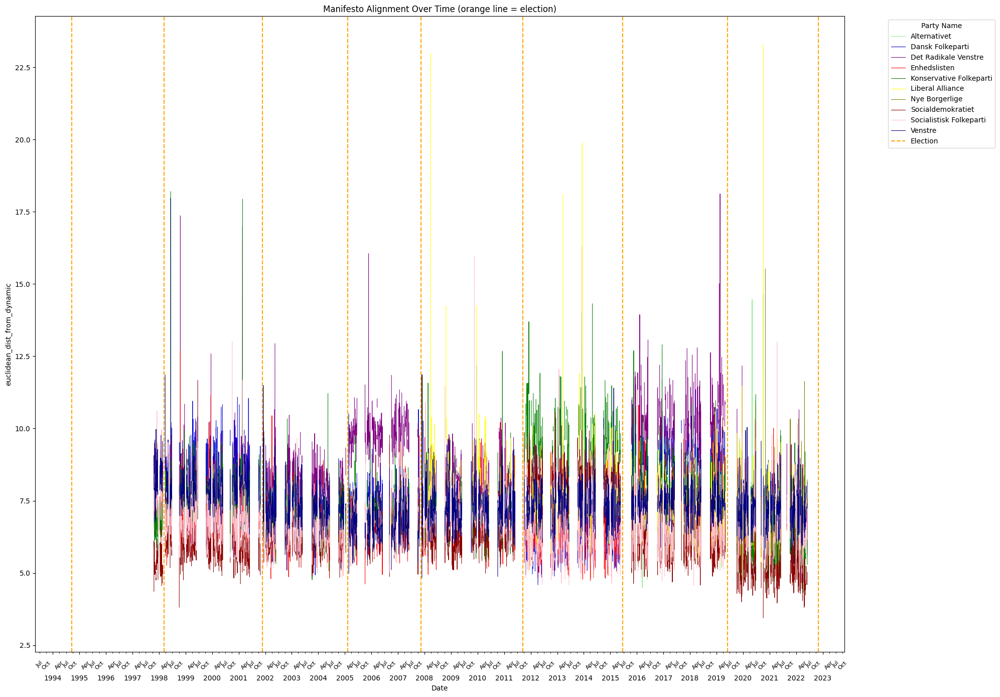

In [34]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import os

def plotting_func(df, colname):

    # Plotting
    fig, ax = plt.subplots(figsize=(20, 14)) 

    # Define color mapping
    color_map = {
        'Det Radikale Venstre': 'purple',
        'Venstre': 'navy',
        'Enhedslisten': 'red',  # bright red
        'Socialdemokratiet': 'darkred',  # rose red or dark red
        'Socialistisk Folkeparti': 'pink',
        'Dansk Folkeparti': 'mediumblue',  # deep blue
        'Konservative Folkeparti': 'green',
        'Inuit Ataqatigiit': 'lightskyblue',  # icy blue
        'Liberal Alliance': 'yellow',
        'Sambandsflokkurin': 'paleturquoise',  # icy blue variant
        'Siumut': 'powderblue',  # another icy blue variant
        'Uden for folketingsgrupperne': 'grey',
        'Kristendemokraterne': 'sandybrown',  # color
        'Tjóðveldi': 'lightcoral',  # light color
        'Javnaðarflokkurin': 'lightpink',  # light color
        'Alternativet': 'lightgreen',
        'Nunatta Qitornai': 'lightblue',  # light color
        'Nye Borgerlige': 'olive',  # military green
        'Frie Grønne': 'limegreen'  # another green variant
    }

    # Election dates
    election_dates = [
        pd.Timestamp('1994-09-21'),
        pd.Timestamp('1998-03-11'),
        pd.Timestamp('2001-11-20'),
        pd.Timestamp('2005-02-08'),
        pd.Timestamp('2007-11-13'),
        pd.Timestamp('2011-09-15'),
        pd.Timestamp('2015-06-18'),
        pd.Timestamp('2019-06-05'),
        pd.Timestamp('2022-11-01')  # Include this date even if unsure about data coverage
    ]

    # Group the df by Party_Name and plot each group
    for (name, group) in df.groupby('Party_Name'):
        # Sort by date to avoid any potential issues with line plotting
        group = group.sort_values(by='Date')
        ax.plot(group['Date'], group[colname], label=name, color=color_map.get(name, 'black'), linewidth=0.75)  

    # Add vertical lines for election dates
    for date in election_dates:
        ax.axvline(x=date, color='orange', linestyle='--', linewidth=1.5, label='Election' if 'Election' not in ax.get_legend_handles_labels()[1] else "")

    # Set plot title and labels
    ax.set_title("Manifesto Alignment Over Time (orange line = election)")
    ax.set_xlabel('Date')
    ax.set_ylabel(f'{colname}')

    # Format the date axis
    ax.xaxis.set_major_locator(mdates.YearLocator())  # Locate years
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))  # Format to show only the year
    ax.xaxis.set_minor_locator(mdates.MonthLocator(bymonth=[1, 4, 7, 10]))  # Locating seasons (January, April, July, October)
    ax.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))  # Format to show month as abbreviated text (Jan, Apr, Jul, Oct)
    ax.tick_params(axis='x', which='major', pad=30, labelsize=10)  # Padding for year labels
    ax.tick_params(axis='x', which='minor', pad=10, labelsize=8, rotation=45)  # Font size and rotation for month labels

    # Get legends with checking for duplicate labels
    handles, labels = ax.get_legend_handles_labels()
    by_label = dict(zip(labels, handles))  # removing duplicates
    ax.legend(by_label.values(), by_label.keys(), title='Party Name', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save the figure
    fig.savefig(f'{directory_path}/nbs/descriptives_explorations/figures/{colname}_alignment.png')

    plt.tight_layout()
    plt.show()

# Example usage
plotting_func(filtered_df_doc_m_complete_dates, 'euclidean_dist_from_dynamic')


## The same plots, but for each deviation variable

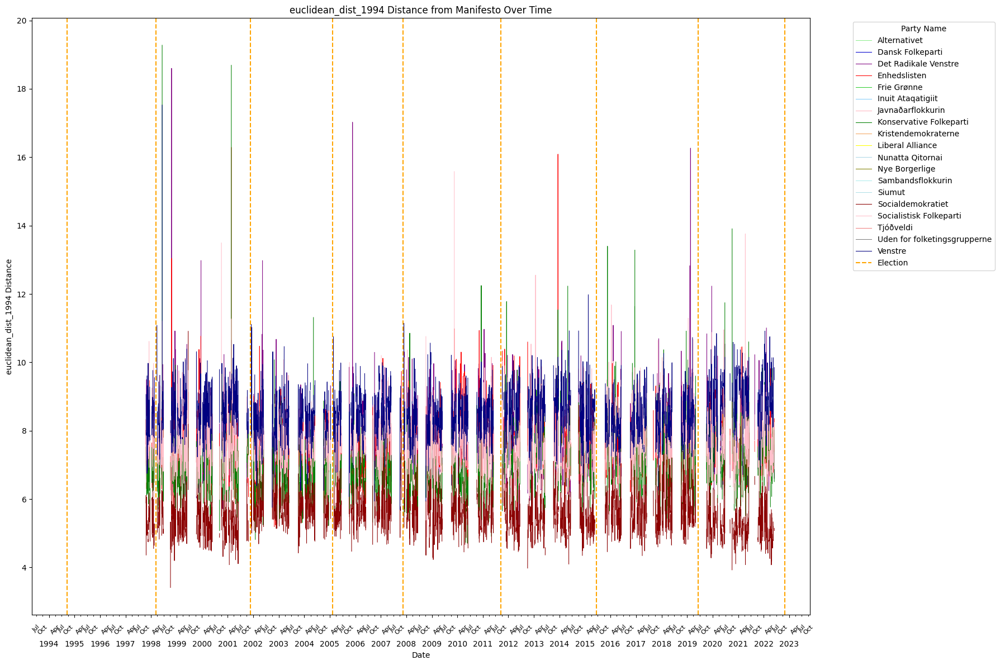

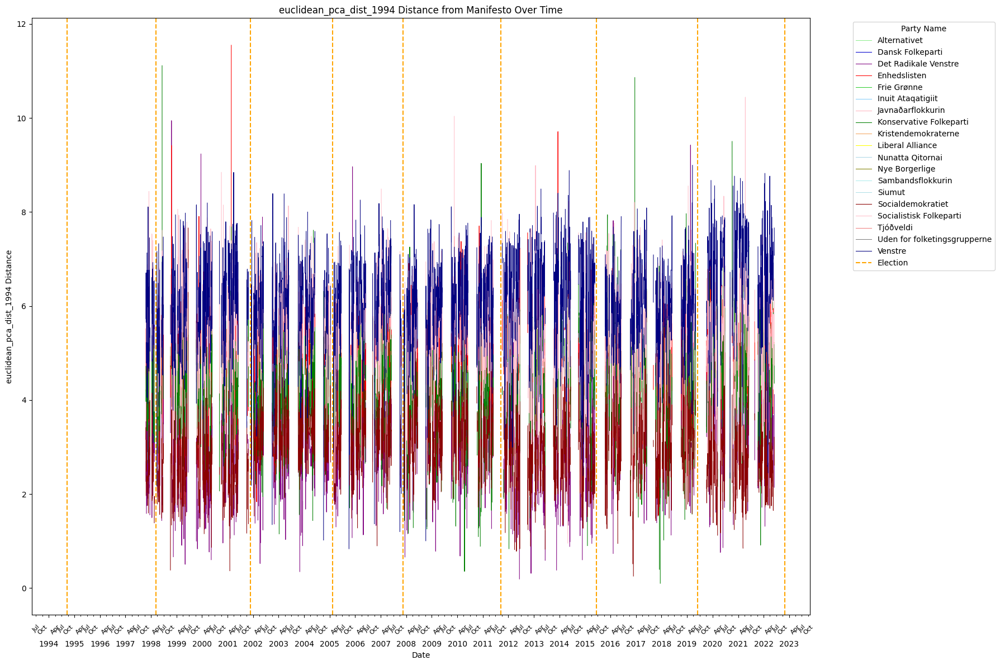

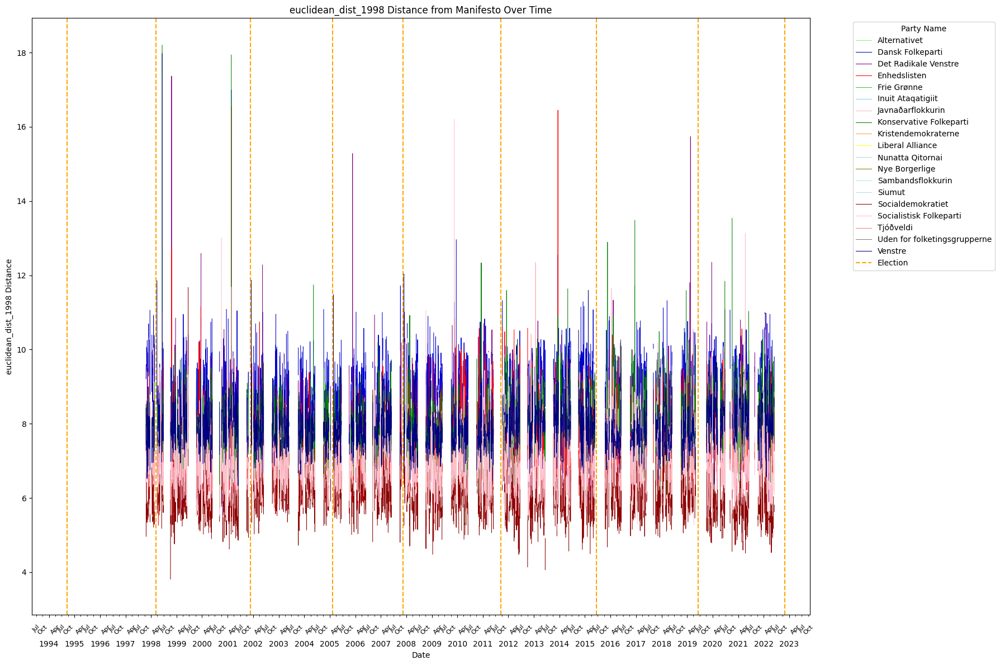

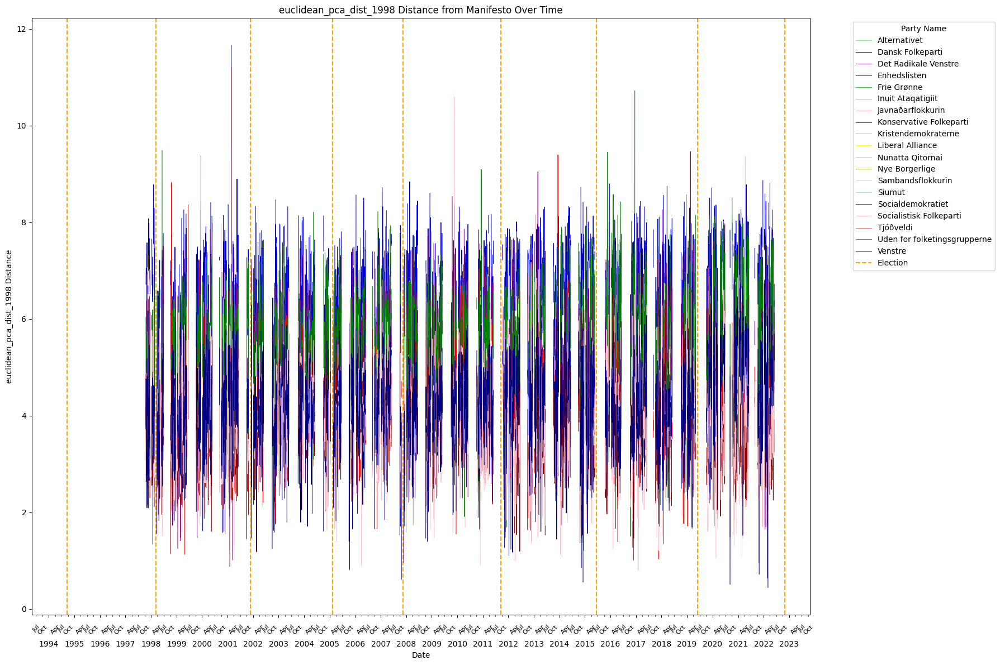

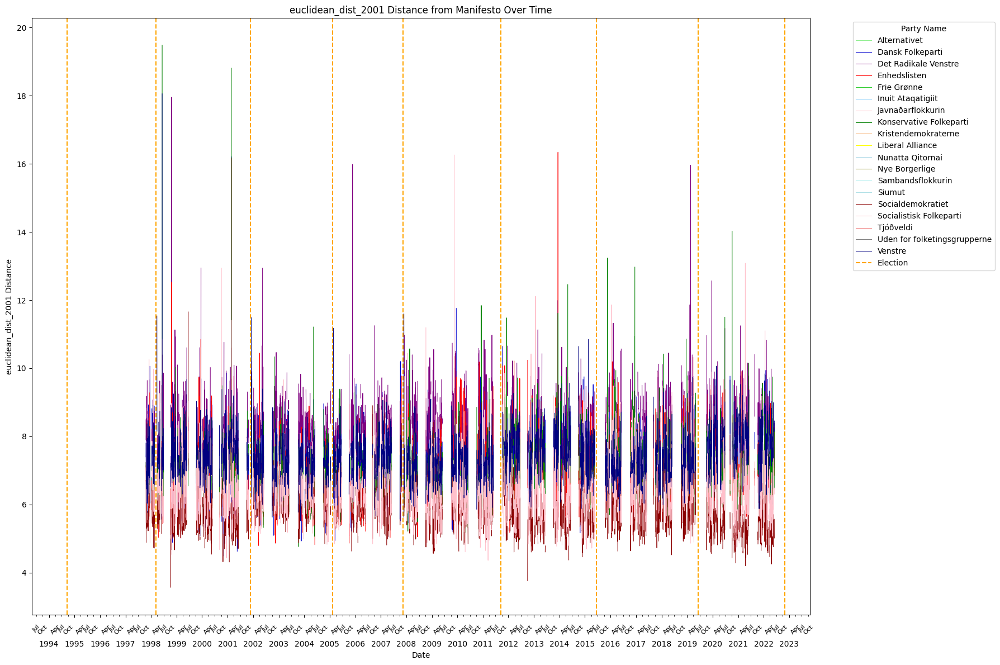

...

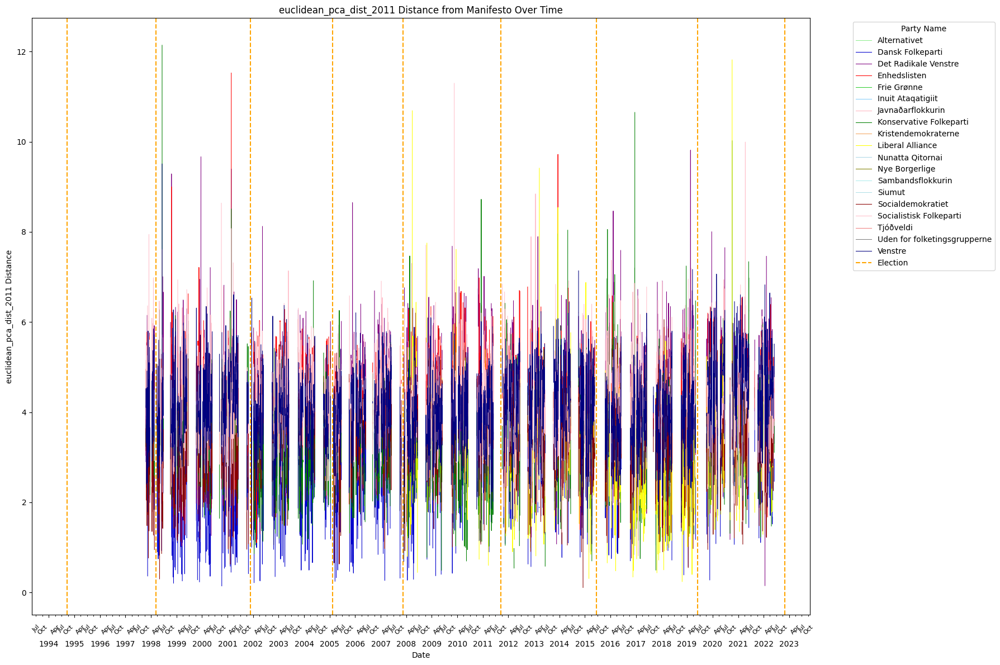

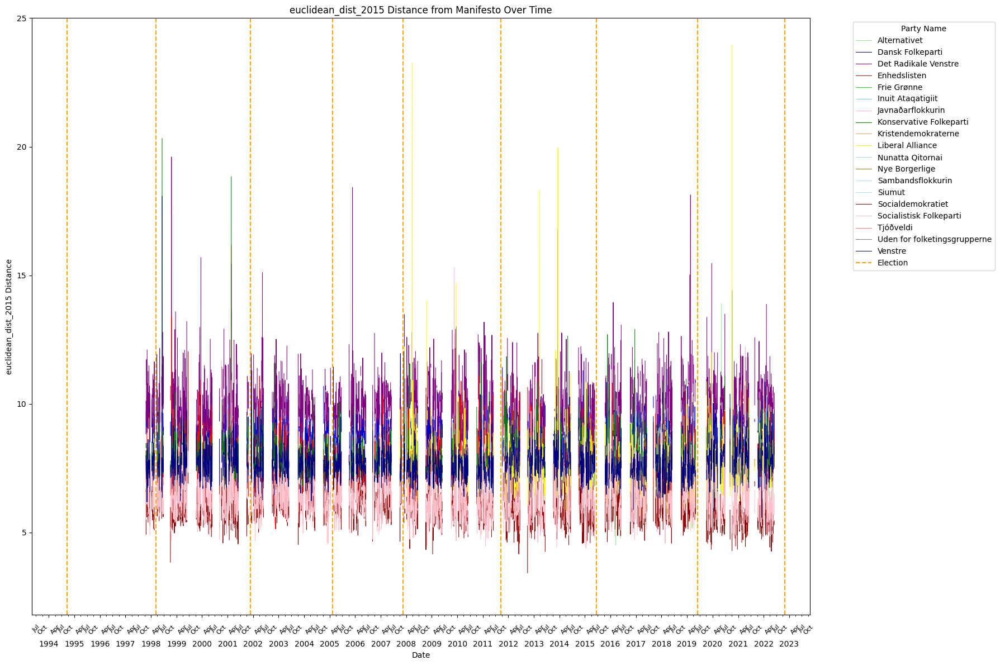

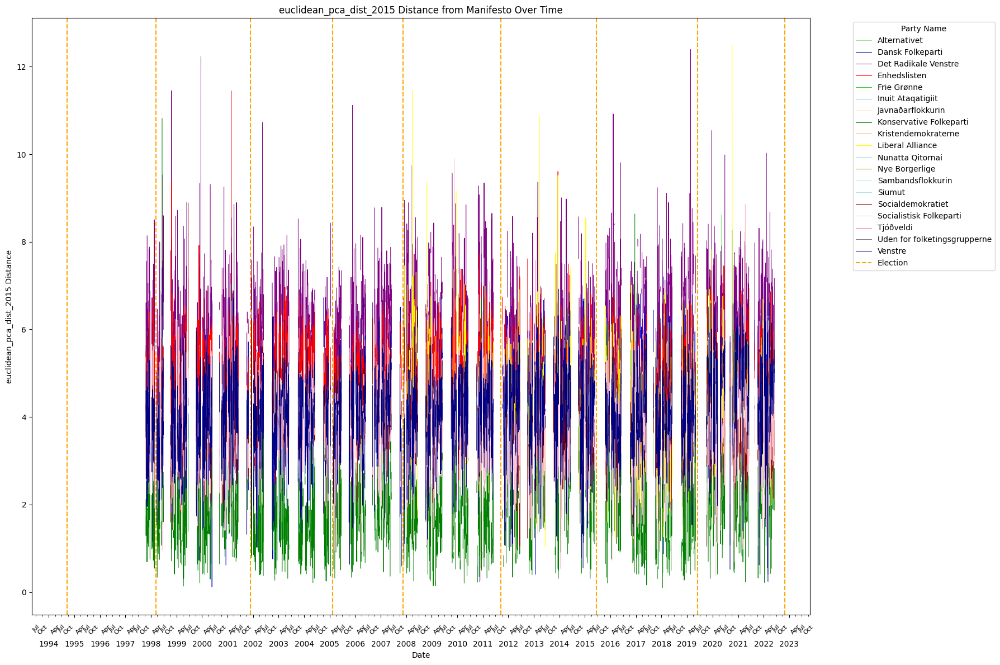

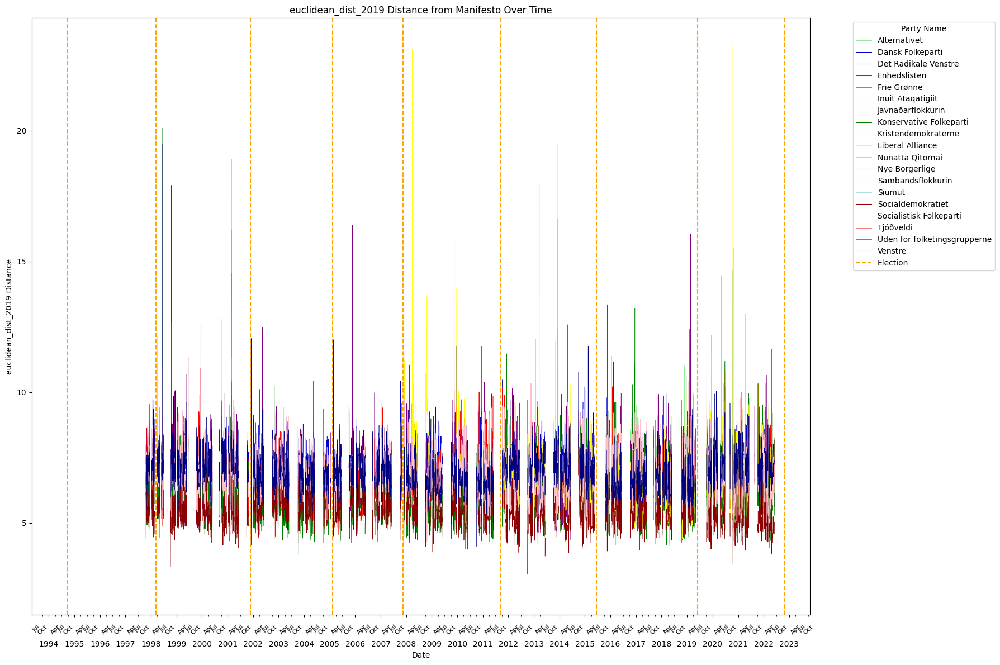

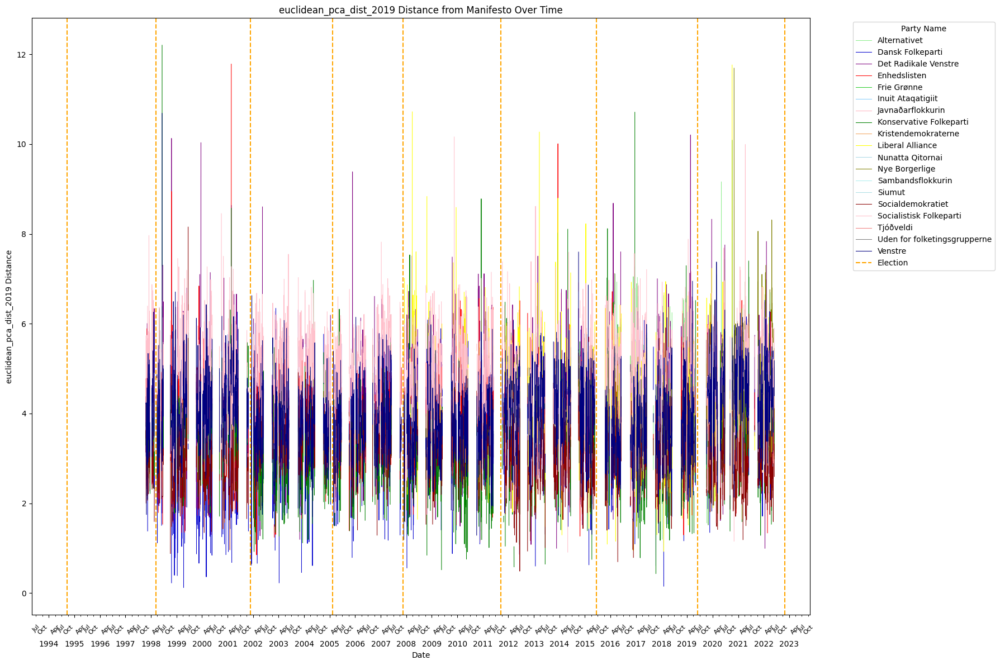

In [27]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

def plotting_func(df, colname):
    # Plotting
    fig, ax = plt.subplots(figsize=(18, 12)) 

    # Define color mapping
    color_map = {
        'Det Radikale Venstre': 'purple',
        'Venstre': 'navy',
        'Enhedslisten': 'red',  # bright red
        'Socialdemokratiet': 'darkred',  # rose red or dark red
        'Socialistisk Folkeparti': 'pink',
        'Dansk Folkeparti': 'mediumblue',  # deep blue
        'Konservative Folkeparti': 'green',
        'Inuit Ataqatigiit': 'lightskyblue',  # icy blue
        'Liberal Alliance': 'yellow',
        'Sambandsflokkurin': 'paleturquoise',  # icy blue variant
        'Siumut': 'powderblue',  # another icy blue variant
        'Uden for folketingsgrupperne': 'grey',
        'Kristendemokraterne': 'sandybrown',  
        'Tjóðveldi': 'lightcoral',  # light color
        'Javnaðarflokkurin': 'lightpink',  # light color
        'Alternativet': 'lightgreen',
        'Nunatta Qitornai': 'lightblue',  # light color
        'Nye Borgerlige': 'olive',  # military green
        'Frie Grønne': 'limegreen'  # another green variant
    }

    # Election dates
    election_dates = [
        pd.Timestamp('1994-09-21'),
        pd.Timestamp('1998-03-11'),
        pd.Timestamp('2001-11-20'),
        pd.Timestamp('2005-02-08'),
        pd.Timestamp('2007-11-13'),
        pd.Timestamp('2011-09-15'),
        pd.Timestamp('2015-06-18'),
        pd.Timestamp('2019-06-05'),
        pd.Timestamp('2022-11-01')  # Include this date even if unsure about data coverage
    ]

    # Group the df by Party_Name and plot each group
    for (name, group) in df.groupby('Party_Name'):

        # Sort by date to avoid any potential issues with line plotting
        group = group.sort_values(by='Date')
        ax.plot(group['Date'], group[colname], label=name, color=color_map.get(name, 'black'), linewidth=0.75)  

    # Add vertical lines for election dates
    for date in election_dates:
        ax.axvline(x=date, color='orange', linestyle='--', linewidth=1.5, label='Election' if 'Election' not in ax.get_legend_handles_labels()[1] else "")

    # Set plot title and labels
    ax.set_title(f'{colname} Distance from Manifesto Over Time')
    ax.set_xlabel('Date')
    ax.set_ylabel(f'{colname} Distance')

    # Format the date axis
    ax.xaxis.set_major_locator(mdates.YearLocator())  # Locate years
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))  # Format to show only the year
    ax.xaxis.set_minor_locator(mdates.MonthLocator(bymonth=[1, 4, 7, 10]))  # Locating seasons (January, April, July, October) because months is too hard to read on this plot
    ax.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))  # Format to show month as abbreviated text (Jan, Apr, Jul, Oct)
    ax.tick_params(axis='x', which='major', pad=30, labelsize=10)  # Padding for year labels
    ax.tick_params(axis='x', which='minor', pad=10, labelsize=8, rotation=45)  # Font size and rotation for month labels

    # Get legends with checking for duplicate labels
    handles, labels = ax.get_legend_handles_labels()
    by_label = dict(zip(labels, handles))  # removing duplicates
    ax.legend(by_label.values(), by_label.keys(), title='Party Name', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Display the plot
    plt.tight_layout()
    plt.show()

years = ['1994', '1998', '2001', '2005', '2007', '2011', '2015', '2019']  # 2022 no manif for

for year in years:
    plotting_func(df_complete, f'euclidean_dist_{year}')
    plotting_func(df_complete, f'euclidean_pca_dist_{year}')


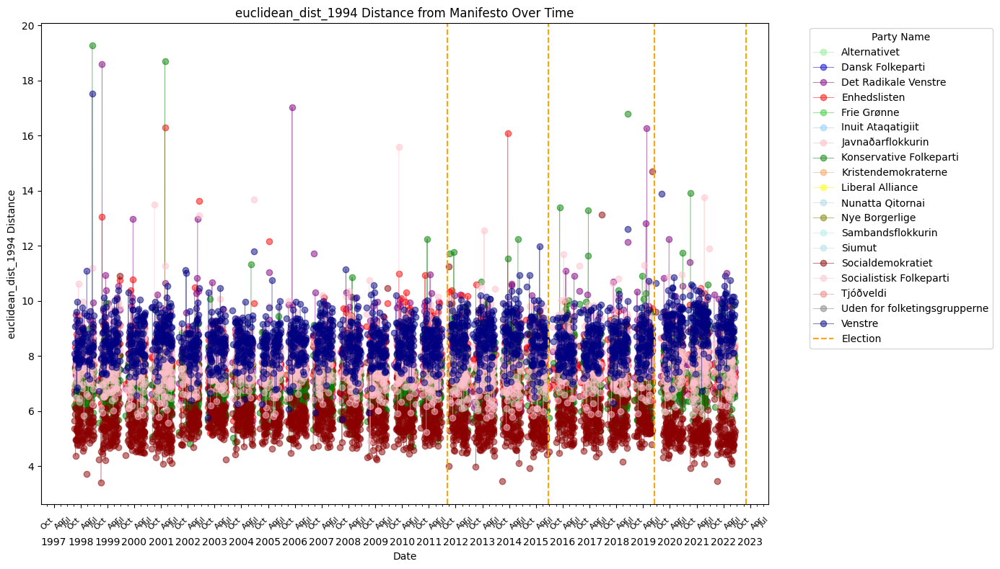

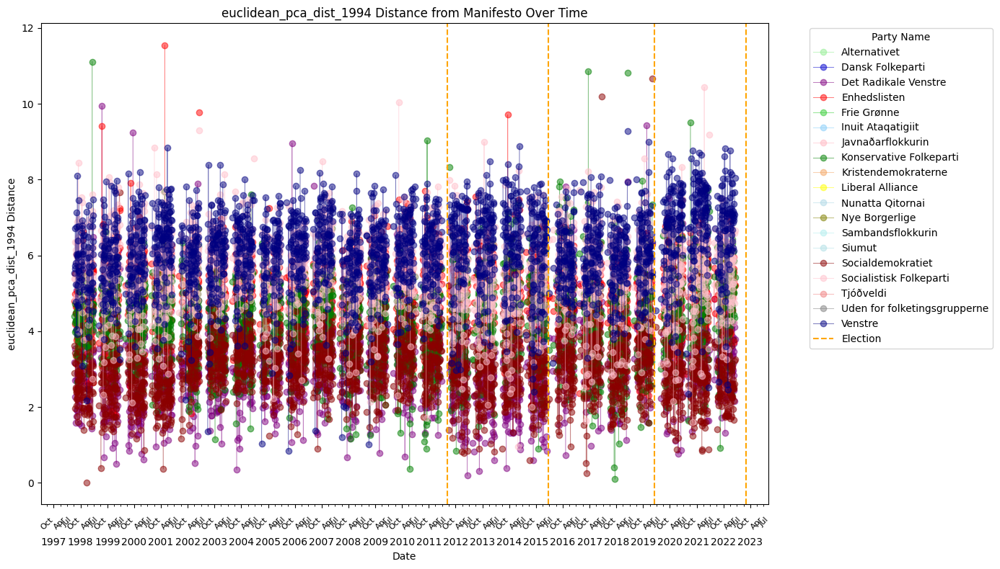

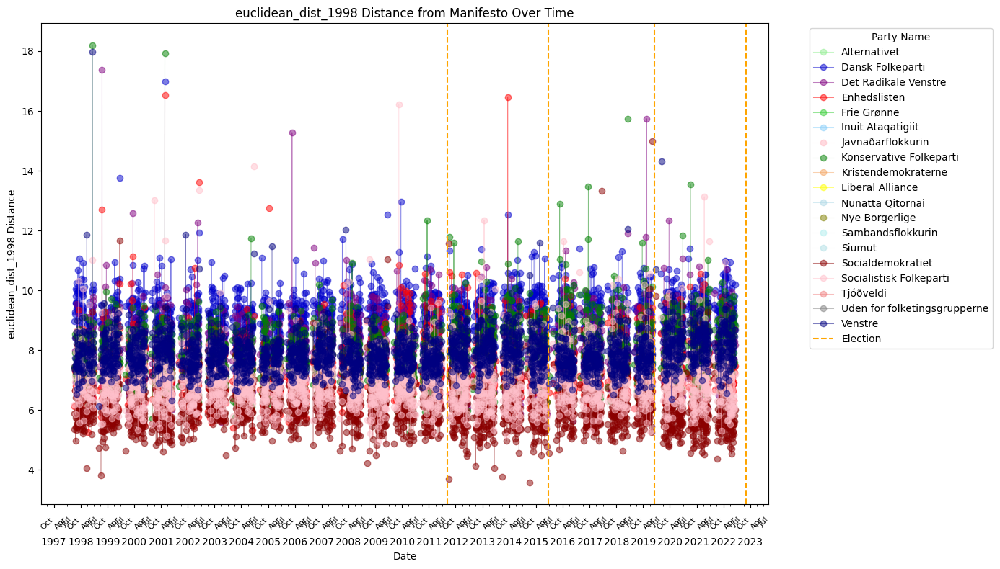

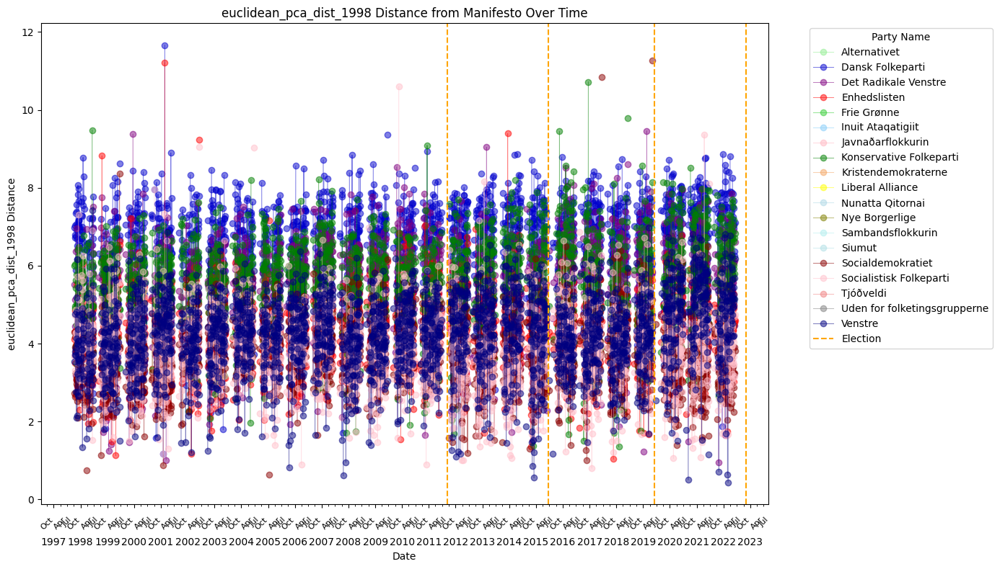

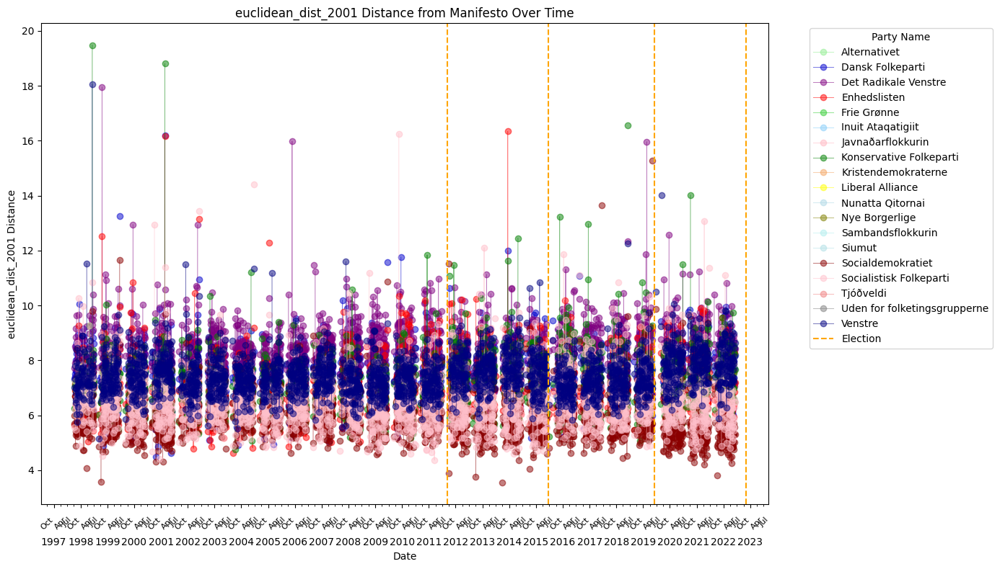

...

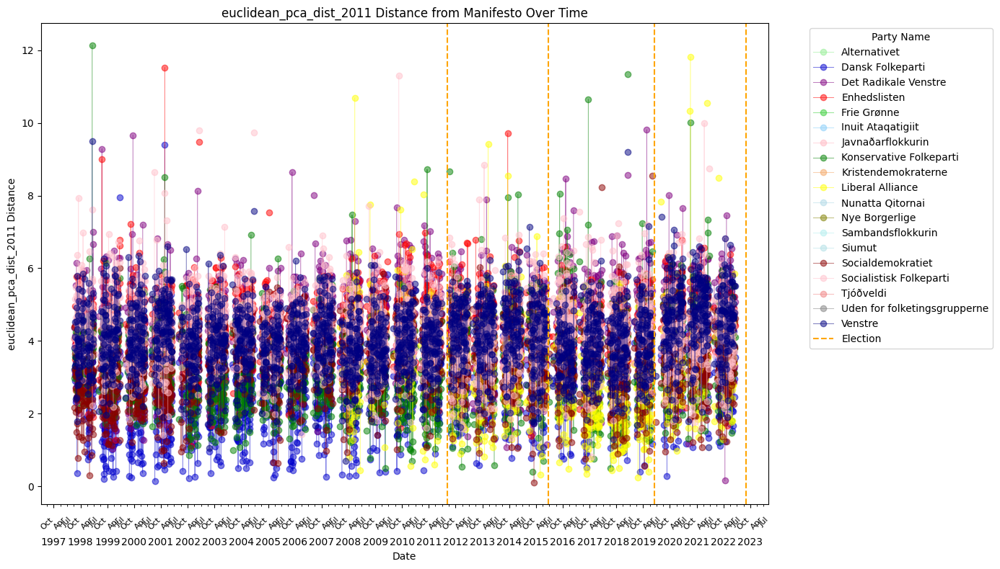

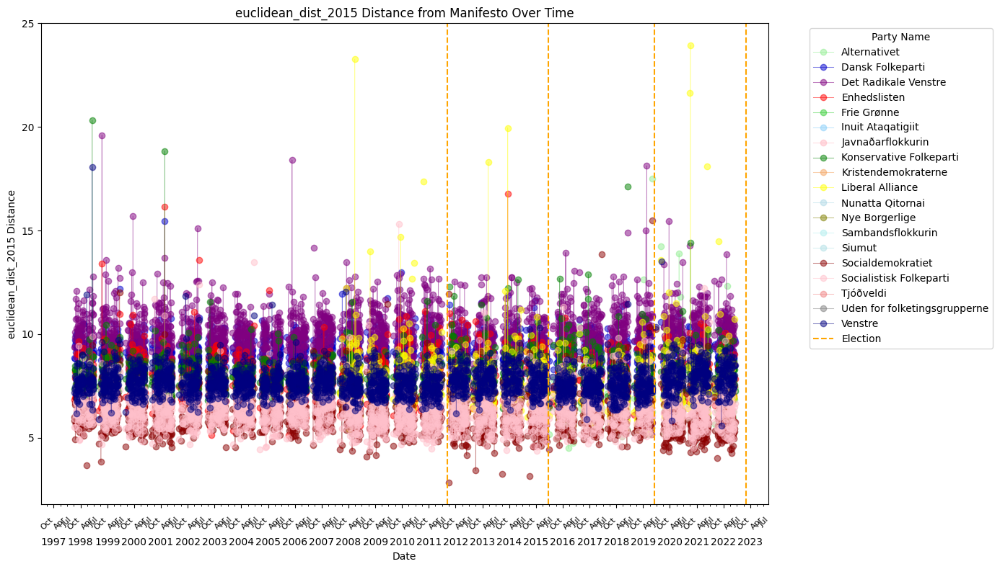

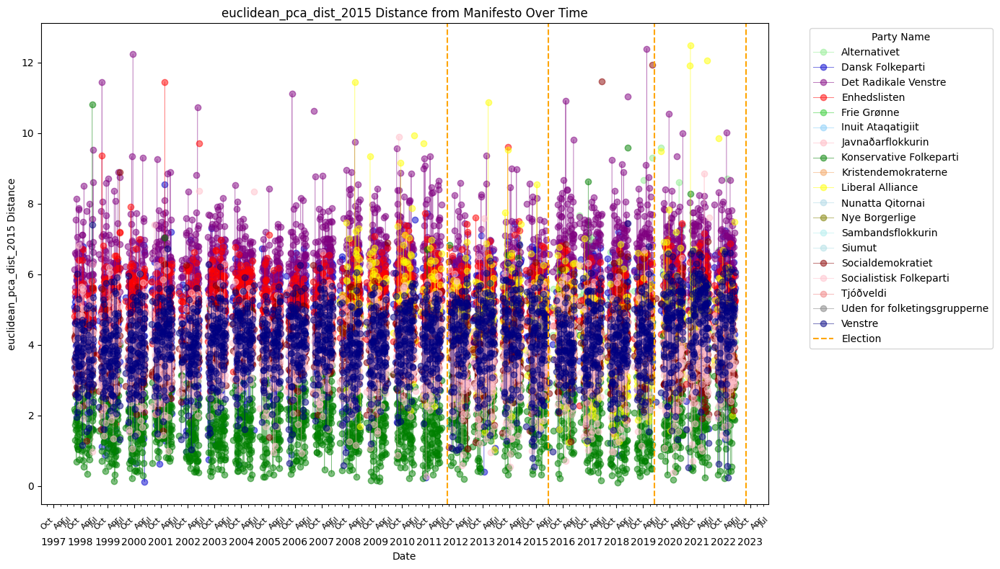

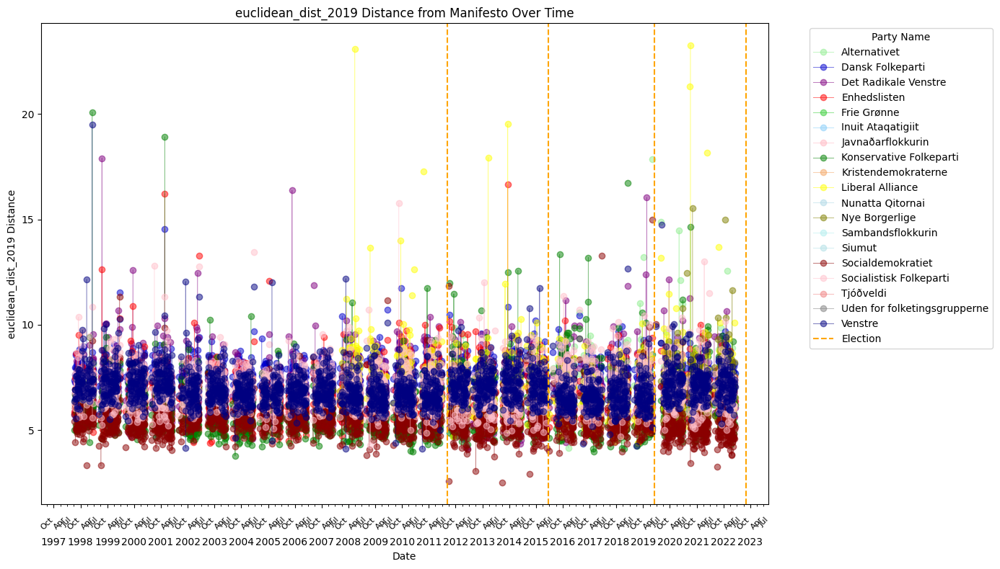

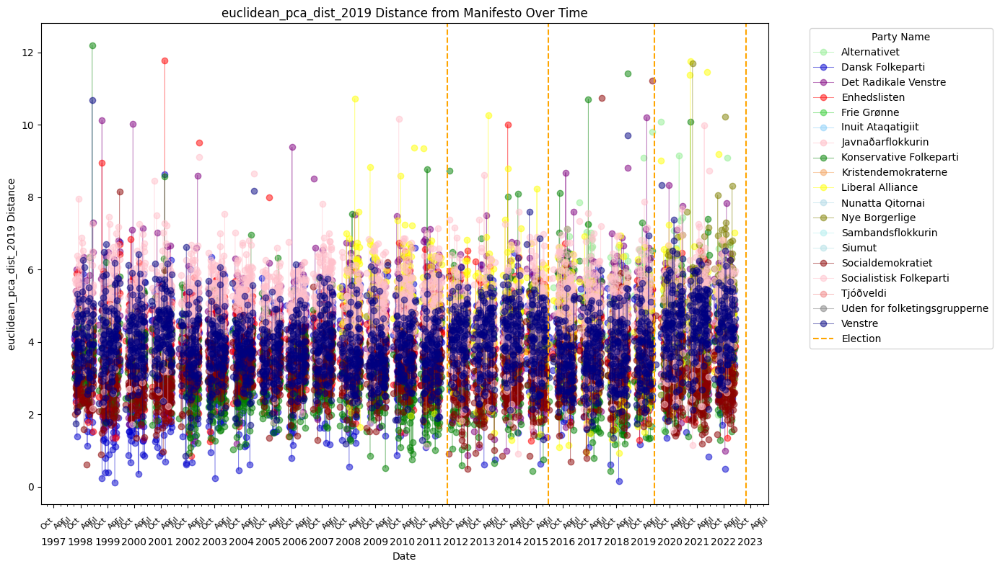

In [35]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

def plotting_func_points(df, colname):
    # Plotting
    fig, ax = plt.subplots(figsize=(14, 8))  # plot size for better visibility

    # Define color mapping for all parties
    color_map = {
        'Det Radikale Venstre': 'purple',
        'Venstre': 'navy',
        'Enhedslisten': 'red',  # bright red
        'Socialdemokratiet': 'darkred',  # rose red or dark red
        'Socialistisk Folkeparti': 'pink',
        'Dansk Folkeparti': 'mediumblue',  # deep blue
        'Konservative Folkeparti': 'green',
        'Inuit Ataqatigiit': 'lightskyblue',  # icy blue
        'Liberal Alliance': 'yellow',
        'Sambandsflokkurin': 'paleturquoise',  # icy blue variant
        'Siumut': 'powderblue',  # another icy blue variant
        'Uden for folketingsgrupperne': 'grey',
        'Kristendemokraterne': 'sandybrown',
        'Tjóðveldi': 'lightcoral',
        'Javnaðarflokkurin': 'lightpink',
        'Alternativet': 'lightgreen',
        'Nunatta Qitornai': 'lightblue',
        'Nye Borgerlige': 'olive',
        'Frie Grønne': 'limegreen'
    }

    # Election dates
    election_dates = [
        pd.Timestamp('2011-09-15'),
        pd.Timestamp('2015-06-18'),
        pd.Timestamp('2019-06-05'),
        pd.Timestamp('2022-11-01')  # Including tentative date
    ]

    # Group the df by Party_Name and plot each group
    for (name, group) in df.groupby('Party_Name'):
        # Sort by date to avoid any potential issues with line plotting
        group = group.sort_values(by='Date')
        ax.plot(group['Date'], group[colname], label=name, color=color_map.get(name, 'black'),
                marker='o', linestyle='-', alpha=0.5, linewidth=0.75)  # Thinner lines with markers

    # Add vertical lines for election dates
    for date in election_dates:
        ax.axvline(x=date, color='orange', linestyle='--', linewidth=1.5, label='Election' if 'Election' not in ax.get_legend_handles_labels()[1] else "")

    # Set plot title and labels
    ax.set_title(f'{colname} Distance from Manifesto Over Time')
    ax.set_xlabel('Date')
    ax.set_ylabel(f'{colname} Distance')
    
     # Format the date axis
    ax.xaxis.set_major_locator(mdates.YearLocator())  # Locate years
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))  # Format to show only the year
    ax.xaxis.set_minor_locator(mdates.MonthLocator(bymonth=[1, 4, 7, 10]))  # Locating seasons (January, April, July, October) because months is too hard to read on this plot
    ax.xaxis.set_minor_formatter(mdates.DateFormatter('%b'))  # Format to show month as abbreviated text (Jan, Apr, Jul, Oct)
    ax.tick_params(axis='x', which='major', pad=30, labelsize=10)  # Padding for year labels
    ax.tick_params(axis='x', which='minor', pad=10, labelsize=8, rotation=45)  # Font size and rotation for month labels

    # Get legends with checking for duplicate labels
    handles, labels = ax.get_legend_handles_labels()
    by_label = dict(zip(labels, handles))  # removing duplicates
    ax.legend(by_label.values(), by_label.keys(), title='Party Name', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Display the plot
    plt.tight_layout()
    plt.show()


years = ['1994',
         '1998',
         '2001',
         '2005',
         '2007',
         '2011',
         '2015',
         '2019'] # 2022 no manif for

for year in years:
    plotting_func_points(df_complete, f'euclidean_dist_{year}')
    plotting_func_points(df_complete, f'euclidean_pca_dist_{year}')